# SEIFA APRA EDA

In [1]:
import pandas as pd
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import folium
from shapely import set_precision
from branca.colormap import linear
from branca.colormap import linear
from branca.element import Template, MacroElement

from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.ensemble import RandomForestRegressor
import numpy as np

In [ ]:
RAW_EXT = Path("../data/raw/external_dataset")
CLE = Path("../data/cleaned")
CUR = Path("../data/curated")

## SEIFA EDA

In [3]:
df = pd.read_csv(CLE / "seifa2021.csv")

# rename columns to uppercase
df = df.rename(columns={
    "irsd": "IRSD",
    "irsad": "IRSAD",
    "ier": "IER",
    "ieo": "IEO"
})

In [4]:
sa2_shapefile = RAW_EXT / "sa2shape/SA2_2021_AUST_GDA2020.shp"
gdf_sa2 = gpd.read_file(sa2_shapefile)

### Distribution

Their distributions are somewhat reasonable normal. With means of very close to 1000 and medians that are close to 1000 as well. Standardise these before using.

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before opera

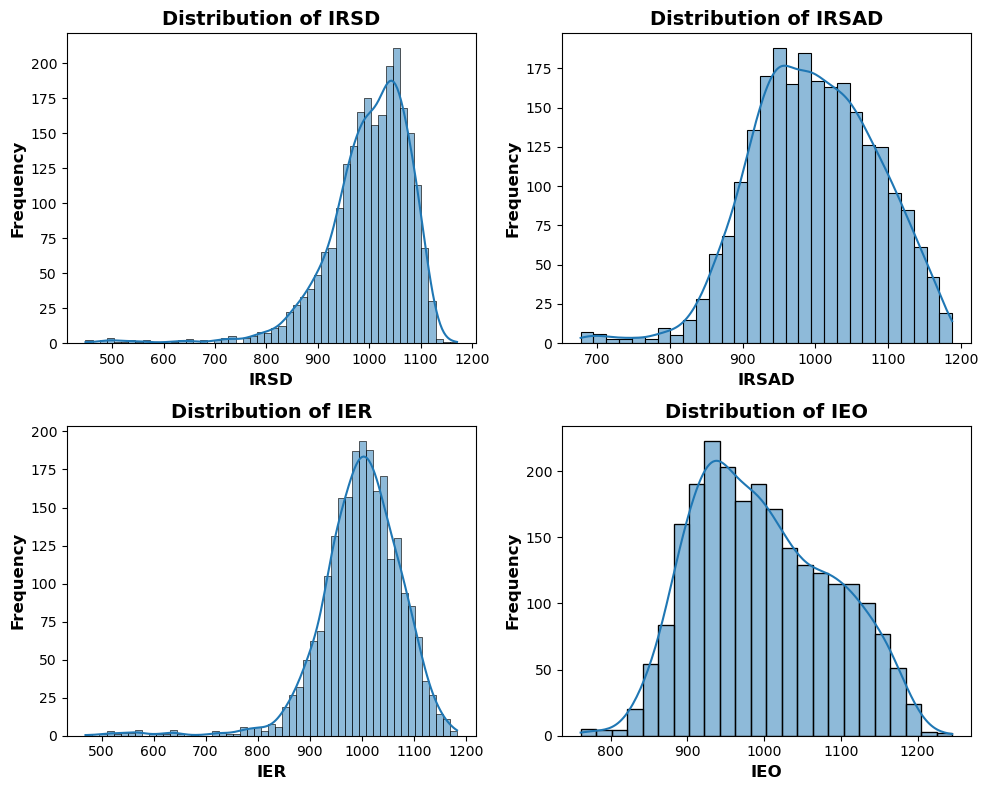

In [5]:
# Plot histograms of SEIFA metrics
seifa_columns = ["IRSD", "IRSAD", "IER", "IEO"]
plt.figure(figsize=(10, 8))
for i, col in enumerate(seifa_columns, 1):
    plt.subplot(2, 2, i)
    sns.histplot(df[col].dropna(), kde=True)
    plt.title(f'Distribution of {col.upper()}', fontweight='bold', fontsize=14)
    plt.xlabel(col.upper(), fontweight='bold', fontsize=12)
    plt.ylabel('Frequency', fontweight='bold', fontsize=12)
plt.tight_layout()

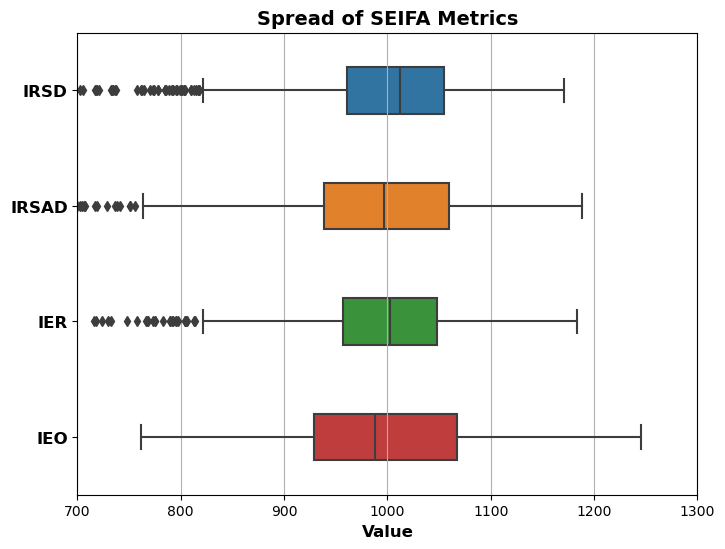

In [6]:
# spread of metrics on a single plot using boxplots
plt.figure(figsize=(8, 6))
sns.boxplot(data=df[seifa_columns], orient='h', width=0.4)
plt.title('Spread of SEIFA Metrics', fontweight='bold', fontsize=14)
plt.xlabel('Value', fontweight='bold', fontsize=12)
plt.yticks(ticks=range(len(seifa_columns)), labels=[col.upper() for col in seifa_columns], fontweight='bold', fontsize=12)
plt.grid(axis='x')
plt.xlim(700, 1300)
plt.show()

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before opera

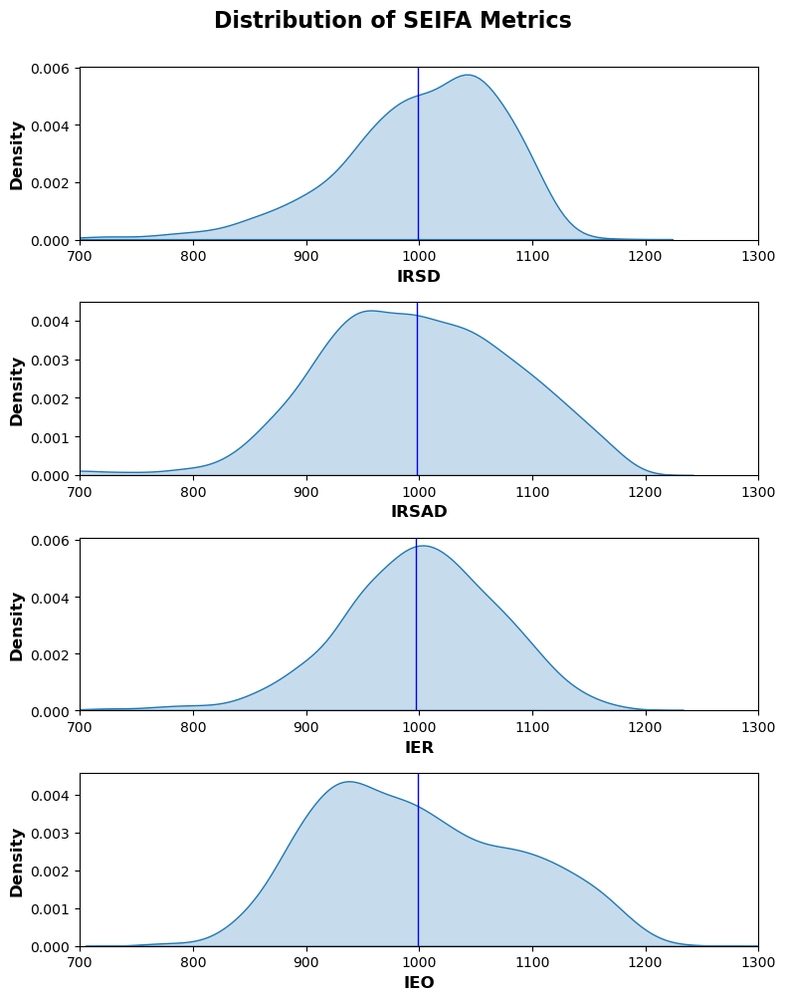

In [7]:
#KDE plots for each metric in the same scale stacked on top of each other in 1 column
plt.figure(figsize=(8, 10))
plt.suptitle("Distribution of SEIFA Metrics", fontweight='bold', fontsize=16, y=1)

for i, col in enumerate(seifa_columns, 1):
    plt.subplot(4, 1, i)
    mean_val = df[col].mean()
    plt.axvline(mean_val, color='blue', linestyle='-', linewidth=1, label=f'Mean: {mean_val:.1f}')
    sns.kdeplot(df[col].dropna(), fill=True)
    plt.xlabel(col.upper(), fontweight='bold', fontsize=12)
    plt.ylabel('Density', fontweight='bold', fontsize=12)
    plt.xlim(700, 1300)

plt.tight_layout()
plt.show()

### Correlation

Most of them are highly correlated with each other, except IER and IEO. Education and occupation is affected by economic resources, but not that heavily.

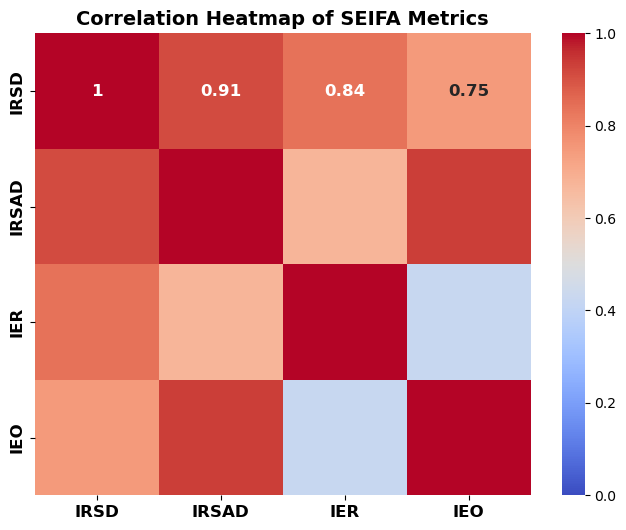

In [8]:
# Correlation heatmap
plt.figure(figsize=(8, 6))
correlation_matrix = df[seifa_columns].corr()
sns.heatmap(
    correlation_matrix,
    annot=True,
    annot_kws={"fontweight": "bold", "fontsize": 12},
    cmap='coolwarm',
    vmin=0,
    vmax=1
)
plt.title('Correlation Heatmap of SEIFA Metrics', fontweight='bold', fontsize=14)
plt.xticks(fontweight='bold', fontsize=12)
plt.yticks(fontweight='bold', fontsize=12)
plt.show()

### Geospatial

High SEIFA metrics values are concentrated in major cities.

In [9]:
# Ensure WGS84 for web maps (if not already)
gdf_sa2 = gdf_sa2.to_crs(4326)

# Reduce vertex count + coordinate precision
gdf_sa2["geometry"] = gdf_sa2["geometry"].map(lambda g: set_precision(g, 1e-5))  # ~1 m-ish precision
gdf_sa2["geometry"] = gdf_sa2["geometry"].simplify(tolerance=0.0007, preserve_topology=True)  # tweak tolerance as needed

# Keep only what's needed and write once
gdf_sa2 = gdf_sa2[["SA2_CODE21", "geometry"]].copy()
geojson_path = RAW_EXT / "seifa/seifa.geojson"
gdf_sa2.to_file(geojson_path, driver="GeoJSON")

In [10]:
df["sa2code"] = df["sa2code"].astype(str)

In [11]:
def build_choropleth(metric, legend):
    m = folium.Map(location=[-25.2744, 133.7751], zoom_start=4, tiles="cartodbpositron")
    
    folium.Choropleth(
        geo_data=gdf_sa2,  
        data=df[["sa2code", metric]].dropna(),                 
        columns=["sa2code", metric],
        key_on="feature.properties.SA2_CODE21",
        fill_color="YlGnBu",
        fill_opacity=0.8,
        line_opacity=0.2,
        legend_name=legend,
        nan_fill_color="white",
        nan_fill_opacity=0.3,
    ).add_to(m)
    
    return m

In [12]:
m = build_choropleth("IRSD", "Index of Relative Socio-economic Disadvantage (IRSD)")
m

In [13]:
m = build_choropleth("IRSAD", "Index of Relative Socio-economic Advantage and Disadvantage (IRSAD)")
m

In [14]:
m = build_choropleth("IER", "Index of Economic Resources (IER)")
m

In [15]:
m = build_choropleth("IEO", "Index of Education and Occupation (IEO)")
m

## APRA EDA

This part of the EDA focuses on areas with banking facilities, the data does not include SA2 codes with no facilities.

In [16]:
df = pd.read_csv(CLE / "apra_pop2021.csv")
outlet_cols = ["ATMs", "Bank_post", "Branch", "Other face-to-face"]
df.head(5)

,Period,States and Territories,SA4 name,SA3 name,SA2 name,ATMs,Bank_post,Branch,Other face-to-face,Total,ATM_prop,Branch_prop,Bank_post_prop,Other_prop
0,2021-06-30,ACT,Australian Capital Territory,Belconnen,Belconnen,16,1,9,1,27,0.592593,0.333333,0.037037,0.037037
1,2021-06-30,ACT,Australian Capital Territory,Belconnen,Bruce,0,1,0,0,1,0.000000,0.000000,1.000000,0.000000
2,2021-06-30,ACT,Australian Capital Territory,Belconnen,Charnwood,1,1,0,0,2,0.500000,0.000000,0.500000,0.000000
3,2021-06-30,ACT,Australian Capital Territory,Belconnen,Gooromon,0,0,1,0,1,0.000000,1.000000,0.000000,0.000000
4,2021-06-30,ACT,Australian Capital Territory,Belconnen,Hawker,1,1,0,0,2,0.500000,0.000000,0.500000,0.000000


### Piecharts

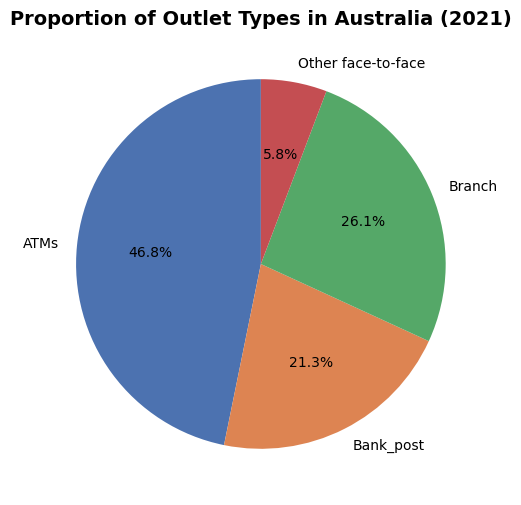

In [17]:
totals = df[outlet_cols].sum()
colors = sns.color_palette("deep")

plt.figure(figsize=(6,6))
plt.pie(
    totals,
    labels=totals.index,
    autopct='%1.1f%%',
    startangle=90,
    colors=colors
)
plt.title("Proportion of Outlet Types in Australia (2021)", fontsize=14, fontweight='bold')
plt.show()

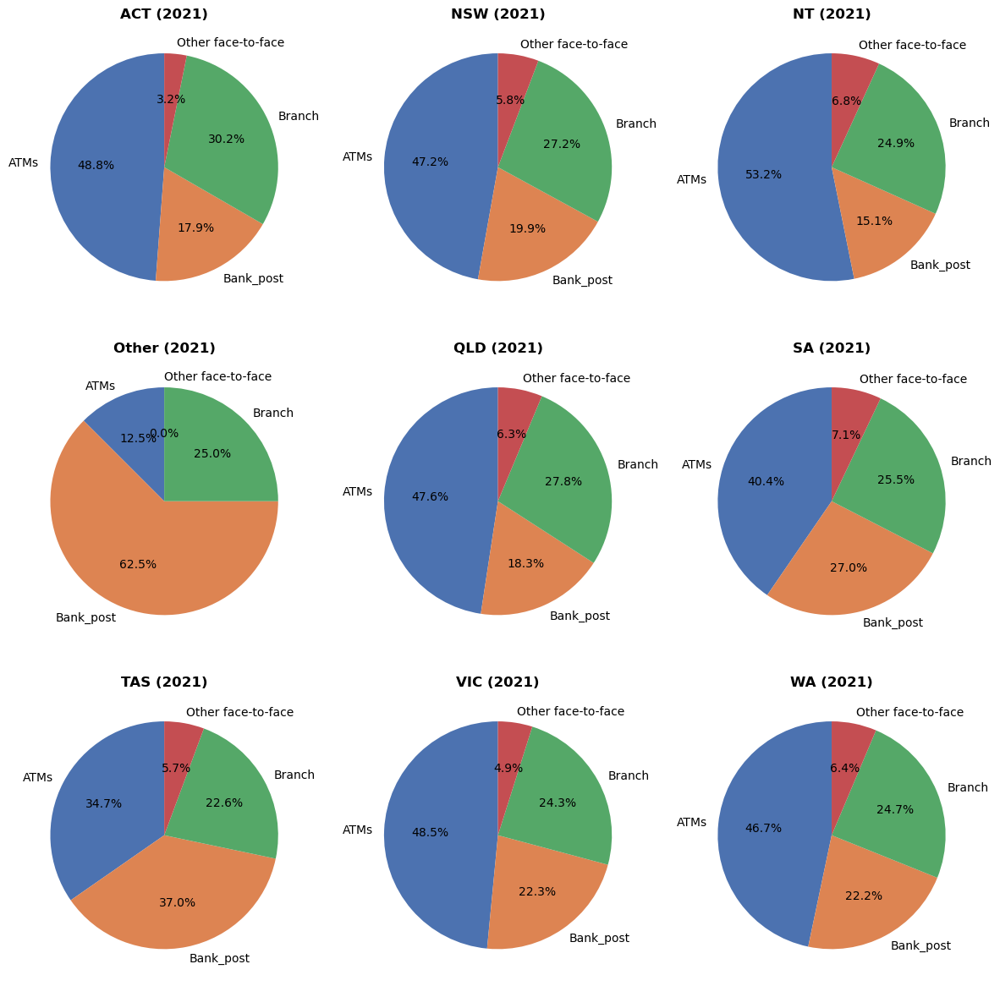

In [18]:
state_totals = df.groupby("States and Territories")[outlet_cols].sum()

fig, axes = plt.subplots(3, 3, figsize=(12, 12))  # 3x3 grid
axes = axes.flatten()  # make it 1D iterable

for ax, (state, values) in zip(axes, state_totals.iterrows()):
    ax.pie(
        values,
        labels=values.index,
        autopct='%1.1f%%',
        startangle=90,
        colors=colors
    )
    ax.set_title(f"{state} (2021)", fontsize=12, fontweight='bold')

# Hide any unused subplots (if <9 states)
for ax in axes[len(state_totals):]:
    ax.axis("off")

plt.tight_layout()
plt.show()

### Distributions

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before opera

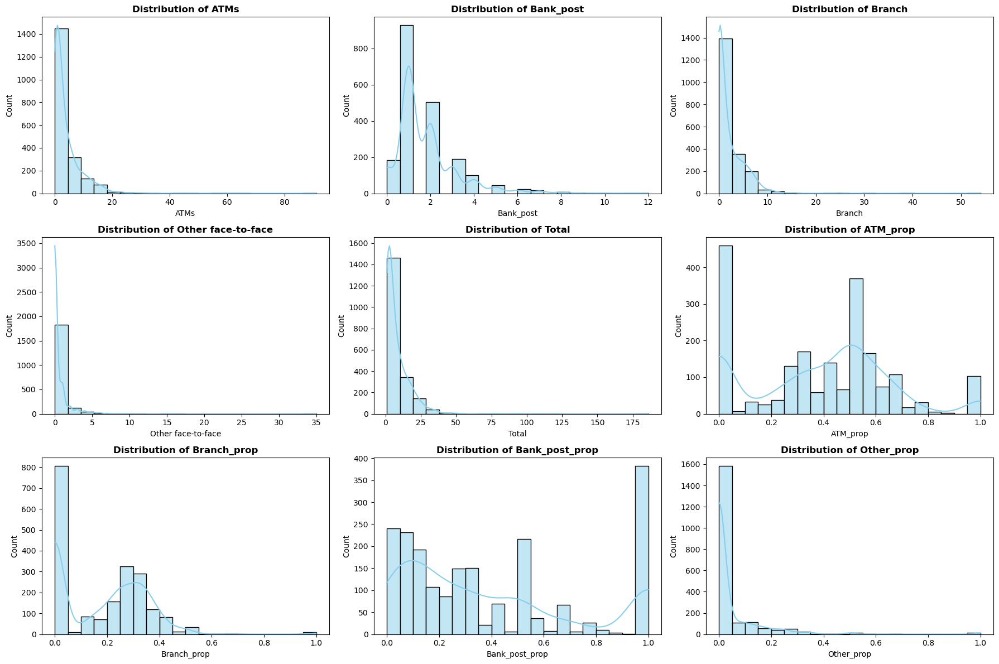

In [19]:
num_cols = [
    "ATMs", "Bank_post", "Branch", "Other face-to-face", "Total",
    "ATM_prop", "Branch_prop", "Bank_post_prop", "Other_prop"
]

# Set up subplots (3x3 since 9 variables)
fig, axes = plt.subplots(3, 3, figsize=(18, 12))
axes = axes.flatten()

for ax, col in zip(axes, num_cols):
    sns.histplot(df[col], kde=True, bins=20, color="skyblue", ax=ax)
    ax.set_title(f"Distribution of {col}", fontsize=12, fontweight="bold")
    ax.set_xlabel(col)
    ax.set_ylabel("Count")

# Hide any unused subplots (if fewer than 9 variables)
for ax in axes[len(num_cols):]:
    ax.axis("off")

plt.tight_layout()
plt.show()

### Correlation

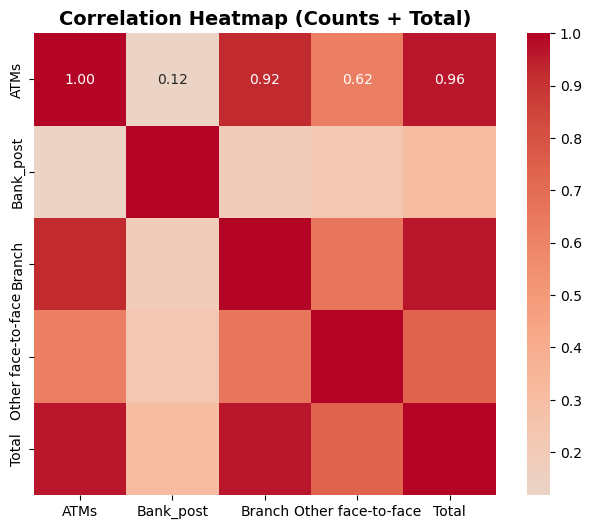

In [20]:
count_cols = ["ATMs", "Bank_post", "Branch", "Other face-to-face", "Total"]
prop_cols = ["ATM_prop", "Branch_prop", "Bank_post_prop", "Other_prop", "Total"]

corr_counts = df[count_cols].corr()

plt.figure(figsize=(8, 6))
sns.heatmap(
    corr_counts,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    center=0,
    square=True
)
plt.title("Correlation Heatmap (Counts + Total)", fontsize=14, fontweight="bold")
plt.show()

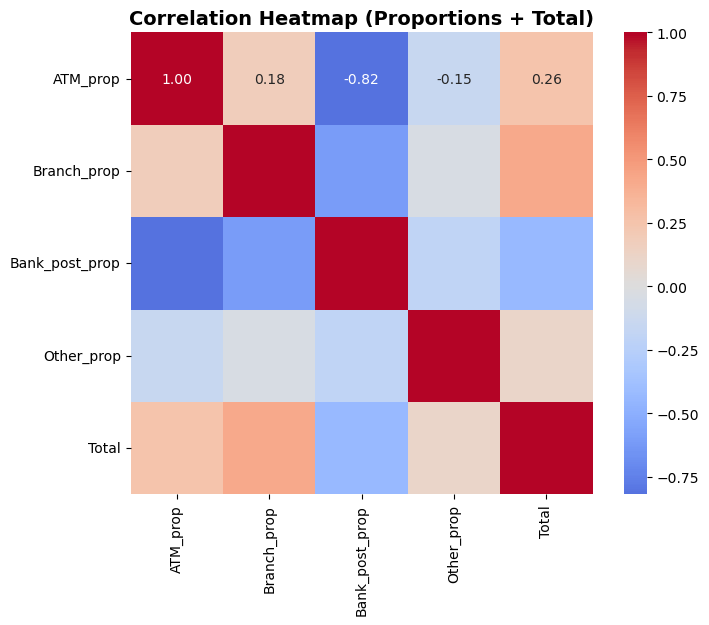

In [21]:
# Heatmap for proportions
corr_props = df[prop_cols].corr()

plt.figure(figsize=(8, 6))
sns.heatmap(
    corr_props,
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    center=0,
    square=True
)
plt.title("Correlation Heatmap (Proportions + Total)", fontsize=14, fontweight="bold")
plt.show()

ATM and Bank@Post are complimentary of each other

### Geospatial Visualizations

In [22]:
sa2_path = RAW_EXT / "sa2shape/SA2_2021_AUST_GDA2020.shp"
gdf_sa2 = gpd.read_file(sa2_path)  # if installed: gpd.read_file(sa2_path, engine="pyogrio", columns=["SA2_CODE21","geometry"])

# Ensure WGS84 for web maps (if not already)
gdf_sa2 = gdf_sa2.to_crs(4326)

# Reduce vertex count + coordinate precision
gdf_sa2["geometry"] = gdf_sa2["geometry"].map(lambda g: set_precision(g, 1e-5))  # ~1 m-ish precision
gdf_sa2["geometry"] = gdf_sa2["geometry"].simplify(tolerance=0.0007, preserve_topology=True)  # tweak tolerance as needed

# Keep only what's needed and write once
gdf_sa2 = gdf_sa2[["SA2_CODE21", "SA2_NAME21", "geometry"]].copy()
geojson_path = RAW_EXT / "apra_pop/simple.geojson"
gdf_sa2.to_file(geojson_path, driver="GeoJSON")

In [23]:
# Join APRA dataset with shapefile
df = df[df["Period"] == "2021-06-30"].copy()  # drop if not needed

# fill numeric NA in the CSV
num_cols = df.select_dtypes(include="number").columns.tolist()
df[num_cols] = df[num_cols].fillna(0)

gdf = gdf_sa2.merge(df, how="left", left_on="SA2_NAME21", right_on="SA2 name")

# fill numeric NA after merge
for c in num_cols:
    if c in gdf.columns:
        gdf[c] = pd.to_numeric(gdf[c], errors="coerce").fillna(0)

In [24]:
# Define metrics + plotting columns ----------------------------------------
count_metrics = ["ATMs", "Bank_post", "Branch", "Other face-to-face", "Total"]
prop_metrics  = ["ATM_prop", "Branch_prop", "Bank_post_prop", "Other_prop"]
all_metrics   = count_metrics + prop_metrics

# add plotting columns: counts -> log10(x+1), proportions -> as-is
plot_col = {}
for m in all_metrics:
    pc = f"__plot_{m.replace(' ', '_')}"
    plot_col[m] = pc
    if m in count_metrics:
        gdf[pc] = np.log10(gdf[m].astype(float) + 1.0)
    else:
        gdf[pc] = gdf[m].astype(float)

# Base map
m = folium.Map(location=[-25.2744, 133.7751], zoom_start=4, tiles="cartodbpositron")

In [25]:
# Helper function to build one layer per metric
def add_metric_layer(metric, show=False):
    pc = plot_col[metric]
    vmin, vmax = float(gdf[pc].min()), float(gdf[pc].max())
    cmap = linear.YlGnBu_09.scale(vmin, vmax)
    cmap.caption = f"{metric} ({'log10(value+1)' if metric in count_metrics else 'proportion'})"

    layer = folium.FeatureGroup(name=metric, show=show)
    # legend note: LayerControl cannot auto-toggle legends without JS;
    # we add the legend for the *default* layer after building layers.
    gj = folium.GeoJson(
        gdf.to_json(),
        name=metric,
        style_function=lambda feat: {
            "fillColor": cmap(feat["properties"].get(pc, 0.0)),
            "color": "#444",
            "weight": 0.3,
            "fillOpacity": 0.8,
        },
        highlight_function=lambda x: {"weight": 1.2, "color": "#000"},
        tooltip=folium.features.GeoJsonTooltip(
            fields=["SA2_NAME21", metric],
            aliases=["SA2", "Value"],
            localize=True,
            sticky=True,
        ),
    )
    gj.add_to(layer)
    layer.add_to(m)
    return cmap  

In [26]:
# Add layers (first one visible by default) ---------------------------------
first_metric = all_metrics[0]
legends = {}
for metric in all_metrics:
    legends[metric] = add_metric_layer(metric, show=(metric == first_metric))

# Add ONE legend matching the initially visible layer (LayerControl can’t sync legends)
legends[first_metric].add_to(m)

In [27]:
# Layer control
folium.LayerControl(collapsed=False).add_to(m)

Uncomment the following to display the map

In [28]:
# m

Bank@Post usually exis in regional areas where there are no access to ATMs and other banking facilities

## Combine SEIFA and APRA Datasets

In [29]:
apra = pd.read_csv(CLE / "apra_pop2021.csv")
seifa = pd.read_csv(CLE / "seifa2021.csv")

In [30]:
norm = lambda s: s.str.replace(r"\s+", " ", regex=True).str.strip().str.lower()
seifa["__key"] = norm(seifa["sa2name"])
apra["__key"]  = norm(apra["SA2 name"])

In [31]:
# Remember which APRA columns are numeric (to zero-fill after merge) ---
apra_num_cols = apra.select_dtypes(include="number").columns.tolist()

# Left join (SEIFA ← APRA)
merged = seifa.merge(apra.drop(columns=["SA2 name"]), on="__key", how="left", validate="m:1")

# Zero-fill only APRA numeric columns where unmatched
for col in apra_num_cols:
    if col in merged.columns:
        merged[col] = merged[col].fillna(0)

# Clean up helper column 
merged = merged.drop(columns="__key")

merged.head(10)

,sa2code,sa2name,irsd,irsad,ier,ieo,population,Period,States and Territories,SA4 name,SA3 name,ATMs,Bank_post,Branch,Other face-to-face,Total,ATM_prop,Branch_prop,Bank_post_prop,Other_prop
0,101021007,Braidwood,1024.0,1001.0,1027.0,1008.0,4343.0,2021-06-30,NSW,Capital Region,Queanbeyan,2.0,1.0,1.0,0.0,4.0,0.500000,0.250000,0.250000,0.000000
1,101021008,Karabar,994.0,982.0,1000.0,967.0,8517.0,2021-06-30,NSW,Capital Region,Queanbeyan,1.0,1.0,0.0,0.0,2.0,0.500000,0.000000,0.500000,0.000000
2,101021009,Queanbeyan,1010.0,998.0,945.0,1000.0,11342.0,2021-06-30,NSW,Capital Region,Queanbeyan,8.0,1.0,7.0,0.0,16.0,0.500000,0.437500,0.062500,0.000000
3,101021010,Queanbeyan - East,1025.0,1015.0,969.0,1025.0,5085.0,2021-06-30,NSW,Capital Region,Queanbeyan,0.0,1.0,0.0,0.0,1.0,0.000000,0.000000,1.000000,0.000000
4,101021012,Queanbeyan West - Jerrabomberra,1098.0,1107.0,1109.0,1080.0,12744.0,2021-06-30,NSW,Capital Region,Queanbeyan,1.0,1.0,1.0,0.0,3.0,0.333333,0.333333,0.333333,0.000000
5,101021610,Googong,1128.0,1154.0,1165.0,1127.0,6224.0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000
6,101021611,Queanbeyan Surrounds,1098.0,1105.0,1135.0,1073.0,16539.0,2021-06-30,NSW,Capital Region,Queanbeyan,1.0,1.0,1.0,0.0,3.0,0.333333,0.333333,0.333333,0.000000
7,101031013,Bombala,965.0,935.0,976.0,919.0,2454.0,2021-06-30,NSW,Capital Region,Snowy Mountains,0.0,2.0,1.0,0.0,3.0,0.000000,0.333333,0.666667,0.000000
8,101031014,Cooma,982.0,953.0,964.0,943.0,6761.0,2021-06-30,NSW,Capital Region,Snowy Mountains,5.0,1.0,5.0,2.0,13.0,0.384615,0.384615,0.076923,0.153846
9,101031015,Cooma Surrounds,1039.0,1007.0,1066.0,985.0,3472.0,2021-06-30,NSW,Capital Region,Snowy Mountains,0.0,1.0,0.0,0.0,1.0,0.000000,0.000000,1.000000,0.000000


### Check correlation of SEIFA and APRA

In [32]:
seifa_cols  = ["irsd", "irsad", "ier", "ieo", "population"]
prop_cols   = ["ATM_prop", "Branch_prop", "Bank_post_prop", "Other_prop"]
count_cols  = ["ATMs", "Bank_post", "Branch", "Other face-to-face", "Total"]

# Ensure numeric
merged[seifa_cols + prop_cols + count_cols] = merged[seifa_cols + prop_cols + count_cols].apply(pd.to_numeric, errors="coerce")

# Correlation submatrices (rows = SEIFA, cols = APRA sets)
corr_props  = merged[seifa_cols + prop_cols].corr().loc[seifa_cols, prop_cols]
corr_counts = merged[seifa_cols + count_cols].corr().loc[seifa_cols, count_cols]

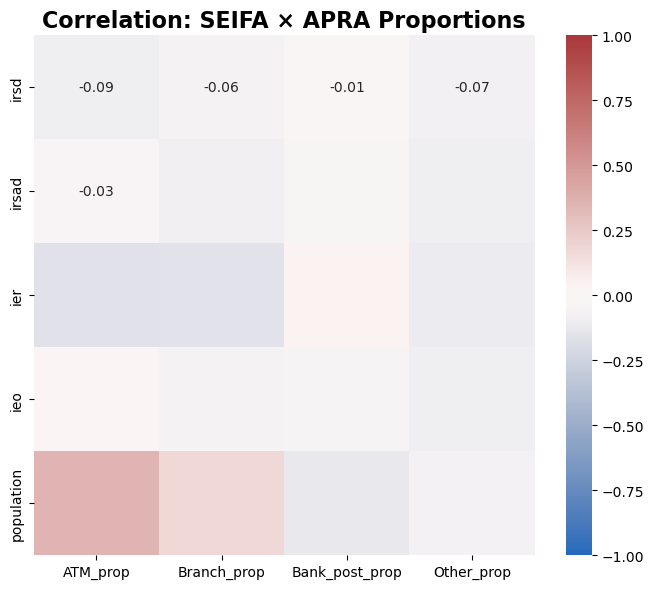

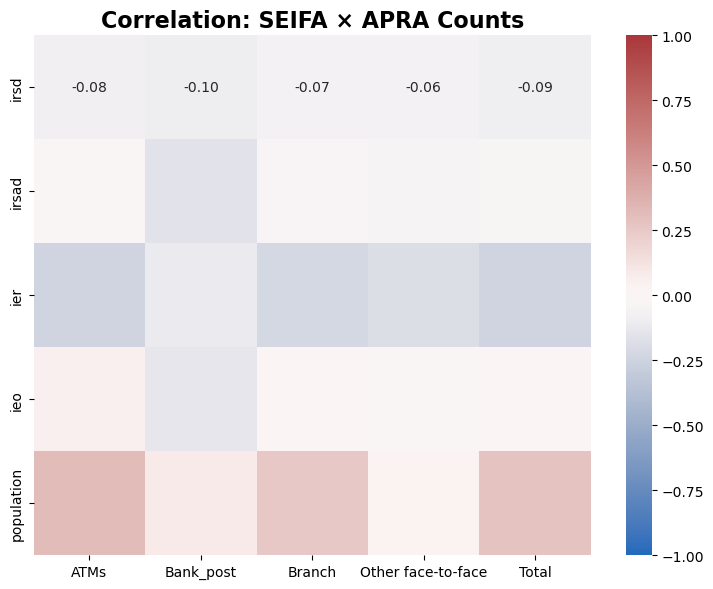

In [33]:
def heat(cm, title):
    plt.figure(figsize=(0.7*cm.shape[1]+4, 0.6*cm.shape[0]+3))
    sns.heatmap(cm, annot=True, fmt=".2f", vmin=-1, vmax=1, center=0, cmap="vlag")
    plt.title(title, fontweight="bold", fontsize=16)
    plt.tight_layout()
    plt.show()

# Plot
heat(corr_props,  "Correlation: SEIFA × APRA Proportions")
heat(corr_counts, "Correlation: SEIFA × APRA Counts")

In [34]:
# Left join seifa and apra on sa2name in seifa and SA2 name in apra
external = seifa.merge(apra, left_on='sa2name', right_on='SA2 name', how='left')

apra_numbers = ['ATMs', 'Bank_post', 'Branch', 'Other face-to-face', 
                'Total', 'ATM_prop', 'Branch_prop', 'Bank_post_prop', 
                'Other_prop']

external[apra_numbers] = external[apra_numbers].fillna(0)
external.drop(columns=['SA4 name', 'SA3 name', 'SA2 name', 'Period'], inplace=True)

## SEIFA Imputation

In [35]:
GCP = "data/curated/gcp_merged_cleaned.csv"
WPP = "data/curated/WPP_cleaned.csv"

gcp = pd.read_csv(GCP)
wpp = pd.read_csv(WPP)
apra_seifa = external

In [36]:
len(gcp), len(wpp), len(apra_seifa)

(2473, 2472, 2366)

In [37]:
gcp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2473 entries, 0 to 2472
Data columns (total 13 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   SA2_code                       2473 non-null   object 
 1   SA2_name                       2473 non-null   object 
 2   state_code                     2473 non-null   object 
 3   state_name                     2473 non-null   object 
 4   geometry                       2454 non-null   object 
 5   median_weekly_personal_income  2416 non-null   float64
 6   household_personal_gap         2416 non-null   float64
 7   dependency_ratio               2473 non-null   float64
 8   pct_youth                      2473 non-null   float64
 9   pct_seniors                    2473 non-null   float64
 10  unemployment_rate              2473 non-null   float64
 11  full_time_share                2416 non-null   float64
 12  part_time_share                2416 non-null   f

In [38]:
wpp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2472 entries, 0 to 2471
Data columns (total 9 columns):
 #   Column                                 Non-Null Count  Dtype
---  ------                                 --------------  -----
 0   Unnamed: 0                             2472 non-null   int64
 1   SA2_code                               2472 non-null   int64
 2   Incorporated                           2472 non-null   int64
 3   Unincorporated                         2472 non-null   int64
 4   Enterprises with no Employees          2472 non-null   int64
 5   Enterprises with not stated Employees  2472 non-null   int64
 6   high_skill_occ                         2472 non-null   int64
 7   med_skill_occ                          2472 non-null   int64
 8   low_skill_occ                          2472 non-null   int64
dtypes: int64(9)
memory usage: 173.9 KB


In [39]:
apra_seifa.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2366 entries, 0 to 2365
Data columns (total 19 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   sa2code                 2366 non-null   int64  
 1   sa2name                 2366 non-null   object 
 2   irsd                    2353 non-null   float64
 3   irsad                   2353 non-null   float64
 4   ier                     2354 non-null   float64
 5   ieo                     2366 non-null   float64
 6   population              2366 non-null   float64
 7   __key_x                 2366 non-null   object 
 8   States and Territories  1949 non-null   object 
 9   ATMs                    2366 non-null   float64
 10  Bank_post               2366 non-null   float64
 11  Branch                  2366 non-null   float64
 12  Other face-to-face      2366 non-null   float64
 13  Total                   2366 non-null   float64
 14  ATM_prop                2366 non-null   

In [40]:
# cast SA2_code to string
gcp["SA2_code"] = gcp["SA2_code"].astype(str)
wpp["SA2_code"] = wpp["SA2_code"].astype(str)
apra_seifa["sa2code"] = apra_seifa["sa2code"].astype(str)

In [41]:
# Remove 'Unnamed: 0' from WPP
wpp = wpp.drop(columns=["Unnamed: 0"], errors="ignore")

# Remove '__key_x' and '__key_y' from APRA-SEIFA dataframe
apra_seifa = apra_seifa.drop(columns=["__key_x", "__key_y"], errors="ignore")
apra_seifa = apra_seifa.drop(columns=["States and Territories"], errors="ignore")

In [42]:
joined_df = gcp.merge(wpp, on="SA2_code", how="left")
joined_df = joined_df.merge(apra_seifa, left_on="SA2_code", right_on="sa2code", how="left")

In [43]:
APRA_COL = ['ATMs', 'Bank_post', 'Branch','Other face-to-face', 'Total', 
            'ATM_prop', 'Branch_prop', 'Bank_post_prop', 'Other_prop']

joined_df[APRA_COL] = joined_df[APRA_COL].fillna(0)

In [44]:
# Check for columns with any missing values
null_counts = joined_df.isnull().sum()
null_cols = null_counts[null_counts > 0]

print("Columns with missing values and their counts:")
print(null_cols.sort_values(ascending=False))

Columns with missing values and their counts:
irsad                                    120
irsd                                     120
ier                                      119
population                               107
sa2code                                  107
ieo                                      107
sa2name                                  107
household_personal_gap                    57
full_time_share                           57
part_time_share                           57
median_weekly_personal_income             57
geometry                                  19
low_skill_occ                              1
med_skill_occ                              1
Enterprises with not stated Employees      1
Enterprises with no Employees              1
Unincorporated                             1
Incorporated                               1
high_skill_occ                             1
dtype: int64


### Model based Imputation

In [45]:
SEIFA_COL = ['irsad', 'irsd', 'ier', 'ieo']

In [46]:
# Select numeric features for imputation (exclude categorical and ID columns)
numeric_cols = joined_df.select_dtypes(include=[np.number]).columns.tolist()
exclude_cols = ['SA2_code', 'merchant_abn', 'Unnamed: 0']  # Non-predictive columns
feature_cols = [col for col in numeric_cols if col not in exclude_cols]

print(f"Features used for imputation: {len(feature_cols)} columns")
print(f"Missing SEIFA values before imputation:")
for col in SEIFA_COL:
    missing_count = joined_df[col].isnull().sum()
    print(f"  {col}: {missing_count} missing values")

Features used for imputation: 29 columns
Missing SEIFA values before imputation:
  irsad: 120 missing values
  irsd: 120 missing values
  ier: 119 missing values
  ieo: 107 missing values


In [47]:
# Initialize IterativeImputer with RandomForest as estimator
imputer = IterativeImputer(
    estimator=RandomForestRegressor(n_estimators=50, random_state=42),
    max_iter=10,
    random_state=42,
    verbose=1
)

# Create a subset with only numeric features for imputation
imputation_data = joined_df[feature_cols].copy()

# Fit and transform the data
print("Performing iterative imputation...")
imputed_data = imputer.fit_transform(imputation_data)

# Update the original dataframe with imputed SEIFA values
imputed_df = pd.DataFrame(imputed_data, columns=feature_cols, index=joined_df.index)
for col in SEIFA_COL:
    if col in feature_cols:
        joined_df[col] = imputed_df[col]

print("\nImputation completed!")
print(f"Missing SEIFA values after imputation:")
for col in SEIFA_COL:
    missing_count = joined_df[col].isnull().sum()
    print(f"  {col}: {missing_count} missing values")

Performing iterative imputation...
[IterativeImputer] Completing matrix with shape (2473, 29)
[IterativeImputer] Change: 12269.40601644607, scaled tolerance: 200.598 
[IterativeImputer] Change: 1701.5655477000003, scaled tolerance: 200.598 
[IterativeImputer] Change: 1630.9810127199999, scaled tolerance: 200.598 
[IterativeImputer] Change: 1486.72043806, scaled tolerance: 200.598 
[IterativeImputer] Change: 905.6126458800002, scaled tolerance: 200.598 
[IterativeImputer] Change: 674.4088679400006, scaled tolerance: 200.598 
[IterativeImputer] Change: 1039.8920456400006, scaled tolerance: 200.598 
[IterativeImputer] Change: 875.2739613399998, scaled tolerance: 200.598 
[IterativeImputer] Change: 1304.5035660200006, scaled tolerance: 200.598 
[IterativeImputer] Change: 1190.0183709000003, scaled tolerance: 200.598 

Imputation completed!
Missing SEIFA values after imputation:
  irsad: 0 missing values
  irsd: 0 missing values
  ier: 0 missing values
  ieo: 0 missing values


/opt/anaconda3/lib/python3.11/site-packages/sklearn/impute/_iterative.py:895: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


In [48]:
# Verify imputation quality
print("SEIFA columns statistics after imputation:")
print(joined_df[SEIFA_COL].describe())

# Check for any remaining missing values in the entire dataset
total_missing = joined_df.isnull().sum().sum()
print(f"\nTotal missing values in dataset: {total_missing}")

SEIFA columns statistics after imputation:
             irsad         irsd          ier          ieo
count  2473.000000  2473.000000  2473.000000  2473.000000
mean    998.919765   999.705095   996.520979   999.707845
std      86.501241    85.900836    82.180842    88.748458
min     677.000000   448.000000   469.000000   761.000000
25%     940.000000   962.000000   954.000000   930.000000
50%     998.000000  1013.000000  1001.000000   988.000000
75%    1063.000000  1058.000000  1049.000000  1071.000000
max    1188.000000  1171.000000  1183.000000  1245.000000

Total missing values in dataset: 575


In [49]:
# Check for columns with any missing values
null_counts = joined_df.isnull().sum()
null_cols = null_counts[null_counts > 0]

print("Columns with missing values and their counts:")
print(null_cols.sort_values(ascending=False))

Columns with missing values and their counts:
sa2code                                  107
sa2name                                  107
population                               107
median_weekly_personal_income             57
household_personal_gap                    57
full_time_share                           57
part_time_share                           57
geometry                                  19
Incorporated                               1
Unincorporated                             1
Enterprises with no Employees              1
Enterprises with not stated Employees      1
high_skill_occ                             1
med_skill_occ                              1
low_skill_occ                              1
dtype: int64


In [50]:
# Output only columns found in the original APRA-SEIFA dataset
output_columns = ['SA2_code'] + SEIFA_COL + APRA_COL
joined_df = joined_df[output_columns]

joined_df.to_csv("data/curated/apra_seifa_imputed.csv", index=False)